#### lisa analysis

1. local moran'i 
2. local moran'i to cell type
3. GM_lag_model: spatial aware deg test.

In [1]:
import sys
sys.path.append('/home/zuolulu/spateo-release')
sys.path.append('/home/zuolulu/dynamo-release')
import spateo as st
import dynamo as dyn
import anndata

/home/zuolulu/.local/lib/python3.9/site-packages/geopandas/_compat.py:111: UserWarning: The Shapely GEOS version (3.10.2-CAPI-1.16.0) is incompatible with the GEOS version PyGEOS was compiled with (3.10.1-CAPI-1.16.0). Conversions between both will be slow.
  warnings.warn(


Jupyter environment detected. Enabling Open3D WebVisualizer.
[Open3D INFO] WebRTC GUI backend enabled.
[Open3D INFO] WebRTCWindowSystem: HTTP handshake server disabled.
|-----> setting visualization default mode in dynamo. Your customized matplotlib settings might be overritten.


In [2]:
ipath = '/home/zuolulu/spatialDEG/test/01.single_slice_mouse_brain_adult/adata_bin50_cluster_domain.h5ad'
adata = anndata.read_h5ad(ipath)
adata = st.pp.filter.filter_genes(adata,min_cells= 1,min_avg_exp = 0.01, min_counts=0)

In [3]:
adata

AnnData object with n_obs × n_vars = 32871 × 11292
    obs: 'area', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_counts', 'Size_Factor', 'initial_cell_size', 'scc_e30_s8', 'louvain', 'domains'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'use_for_pca', 'pass_basic_filter'
    uns: 'PCs', '__type', 'explained_variance_ratio_', 'louvain', 'louvain_colors', 'neighbors', 'pca_mean', 'pp', 'scc_e30_s8', 'scc_e30_s8_colors', 'spatial', 'spatial_neighbors'
    obsm: 'X_pca', 'X_spatial', 'bbox', 'contour', 'spatial', 'tissue_mask'
    layers: 'spliced', 'unspliced'
    obsp: 'connectivities', 'distances', 'spatial_connectivities', 'spatial_distances'

downsample cells from 32871 to 5000, to improve the computing time.

In [4]:
import random
random.seed(2)
index = random.sample(range(32871),5000)
adata_sample = adata[index,:]
adata_sample

View of AnnData object with n_obs × n_vars = 5000 × 11292
    obs: 'area', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_counts', 'Size_Factor', 'initial_cell_size', 'scc_e30_s8', 'louvain', 'domains'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'use_for_pca', 'pass_basic_filter'
    uns: 'PCs', '__type', 'explained_variance_ratio_', 'louvain', 'neighbors', 'pca_mean', 'pp', 'scc_e30_s8', 'spatial', 'spatial_neighbors'
    obsm: 'X_pca', 'X_spatial', 'bbox', 'contour', 'spatial', 'tissue_mask'
    layers: 'spliced', 'unspliced'
    obsp: 'connectivities', 'distances', 'spatial_connectivities', 'spatial_distances'

In [6]:
import pandas as pd
m_filter = pd.read_csv("/zfs-1/zuolulu/spatialDEG/test/01.single_slice_mouse_brain_adult/mouse_brain_morani_filter.csv",index_col=0)
m_filter

Fist, using 'st.tl.lisa_geo_df' we perform 'Local Indicators of Spatial Association (LISA)' analyses on specific genes and prepare a geopandas dataframe for downstream lisa plots to reveal the quantile plots and the hotspot, coldspot, doughnut and diamond regions. Here, we show the specfic genes, Plp1 and Slc6a3.

In [8]:
lisa, df = st.tl.lisa_geo_df(adata_sample,n_neighbors=5,gene='Plp1')

plot the results of local moran_i

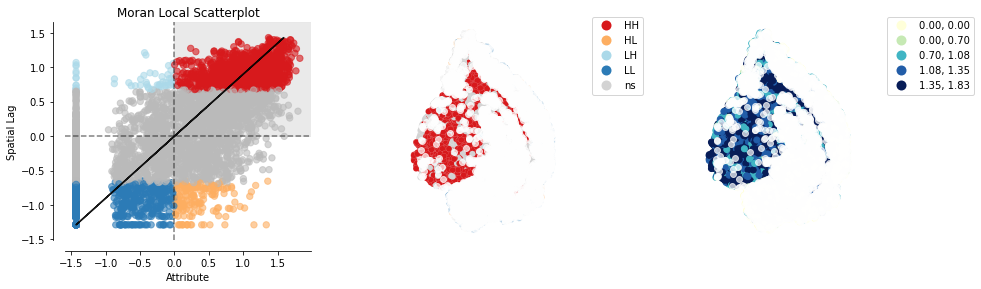

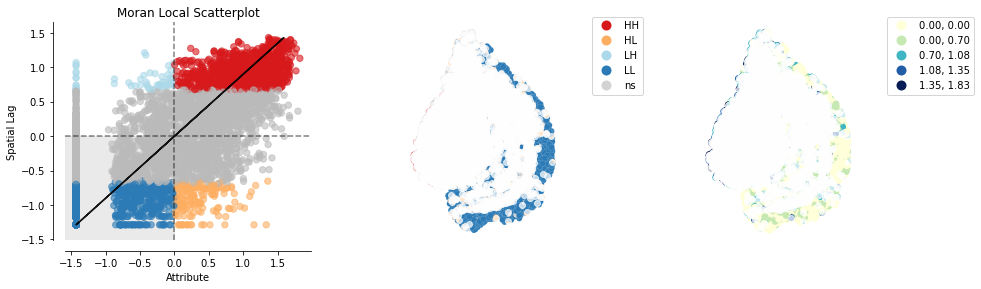

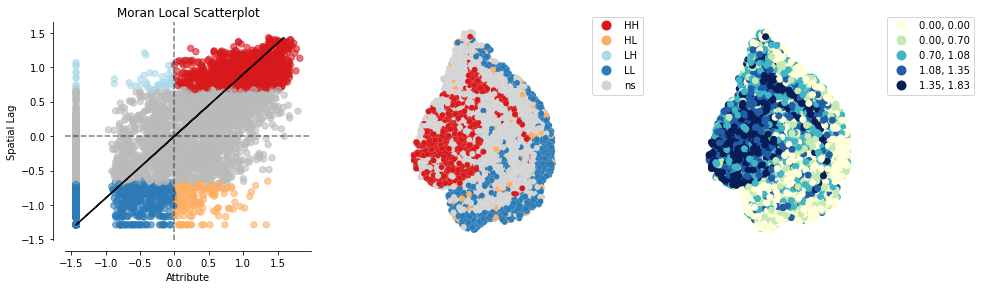

In [9]:
outdir = '/zfs-1/zuolulu/spatialDEG/test/01.single_slice_mouse_brain_adult/'
from splot.esda import plot_local_autocorrelation
import matplotlib.pyplot as plt
plot_local_autocorrelation(lisa, df, 'exp',quadrant=1)
plt.savefig(outdir+'Plp1_lisa_1.pdf', dpi=1000)
plot_local_autocorrelation(lisa, df, 'exp',quadrant=3)
plt.savefig(outdir+'Plp1_lisa_3.pdf', dpi=1000)
plot_local_autocorrelation(lisa, df, 'exp')
plt.savefig(outdir+'Plp1_lisa.pdf', dpi=1000)

In [10]:
lisa, df = st.tl.lisa_geo_df(adata_sample,n_neighbors=5,gene='Slc6a3')

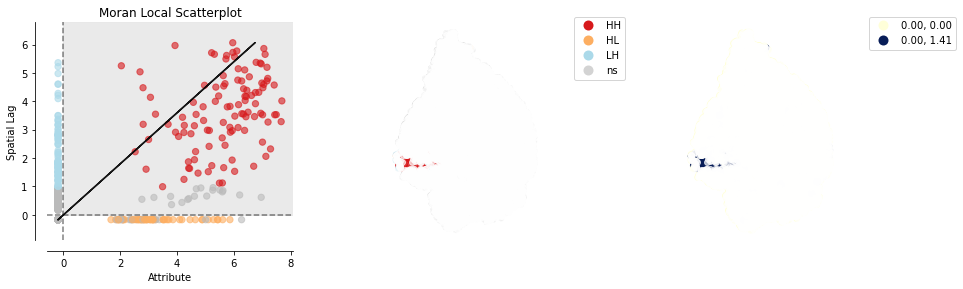

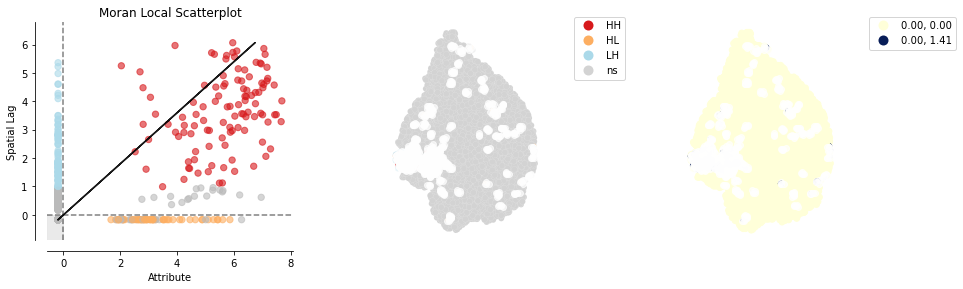

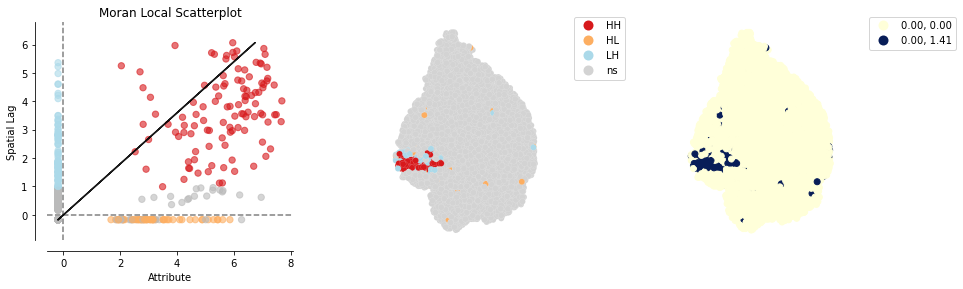

In [11]:
plot_local_autocorrelation(lisa, df, 'exp',quadrant=1)
plt.savefig(outdir+'Slc6a3_lisa_1.pdf', dpi=1000)
plot_local_autocorrelation(lisa, df, 'exp',quadrant=3)
plt.savefig(outdir+'Slc6a3_lisa_3.pdf', dpi=1000)
plot_local_autocorrelation(lisa, df, 'exp')
plt.savefig(outdir+'Slc6a3_lisa.pdf', dpi=1000)

Second, we identify cell type specific genes with local Moran's I test. 'st.tl.local_moran_i'

In [11]:
res = st.tl.local_moran_i(adata_sample,group='scc_e30_s8')

/home/zuolulu/.local/lib/python3.9/site-packages/geopandas/_compat.py:111: UserWarning: The Shapely GEOS version (3.10.2-CAPI-1.16.0) is incompatible with the GEOS version PyGEOS was compiled with (3.10.1-CAPI-1.16.0). Conversions between both will be slow.
  warnings.warn(
/home/zuolulu/.local/lib/python3.9/site-packages/geopandas/_compat.py:111: UserWarning: The Shapely GEOS version (3.10.2-CAPI-1.16.0) is incompatible with the GEOS version PyGEOS was compiled with (3.10.1-CAPI-1.16.0). Conversions between both will be slow.
  warnings.warn(
/home/zuolulu/.local/lib/python3.9/site-packages/geopandas/_compat.py:111: UserWarning: The Shapely GEOS version (3.10.2-CAPI-1.16.0) is incompatible with the GEOS version PyGEOS was compiled with (3.10.1-CAPI-1.16.0). Conversions between both will be slow.
  warnings.warn(
/home/zuolulu/.local/lib/python3.9/site-packages/geopandas/_compat.py:111: UserWarning: The Shapely GEOS version (3.10.2-CAPI-1.16.0) is incompatible with the GEOS version PyG

In [13]:
import pandas as pd
markers_df = pd.DataFrame(res).query("hotspot_frac_val > 0.05 & mean_counts > 0.05").groupby(['hotspot_spec_group'])['hotspot_spec_val'].nlargest(5)
markers_df

hotspot_spec_group          
0                   Ptms        0.752525
                    Actb        0.684211
                    Slc17a7     0.676923
                    Ppp3ca      0.673797
                    Gpm6a       0.671171
1                   Atp6ap1l    0.359551
                    Ptprr       0.327731
                    Hs3st2      0.322581
                    Exoc6       0.317308
                    Cdkl4       0.314286
2                   Zc3h7a      0.471910
                    Gphn        0.442623
                    Jarid2      0.421053
                    Fgfr2       0.420635
                    Gm26561     0.390244
3                   Osbpl3      0.268817
                    Gls2        0.254545
                    Trhde       0.252033
                    Hrasls      0.246914
                    Lypd6       0.234848
4                   Prdm8       0.279720
                    Prr16       0.265957
                    Gm15155     0.258824
                    Cdh7    

plot the Locally enriched genes and their corresponding cell types.

|-----> Plotting spatial info on adata
|-----------> plotting with basis key=X_spatial
|-----------> skip filtering scc_e30_s8 by stack threshold when stacking color because it is not a numeric type


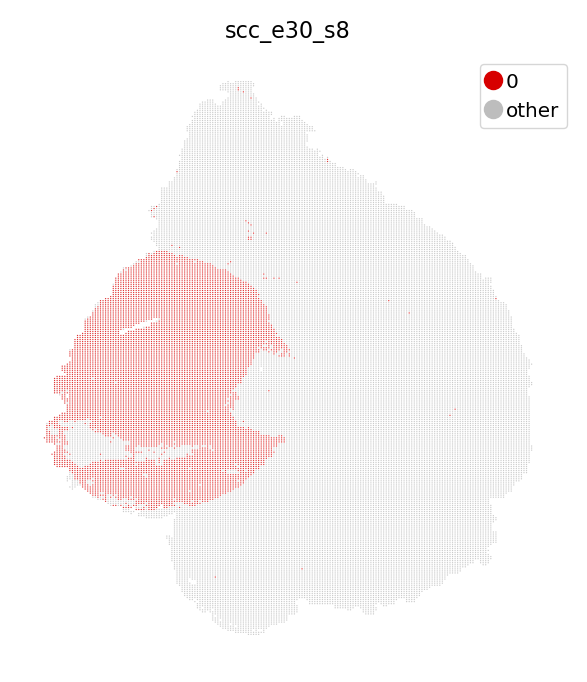

|-----> [space plot] in progress: 100.0000%
|-----> [space plot] finished [0.3337s]


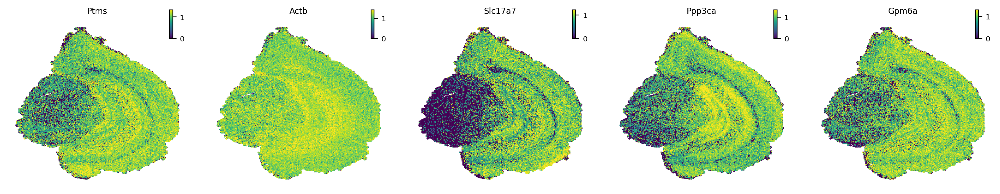

|-----> Plotting spatial info on adata
|-----------> plotting with basis key=X_spatial
|-----------> skip filtering scc_e30_s8 by stack threshold when stacking color because it is not a numeric type


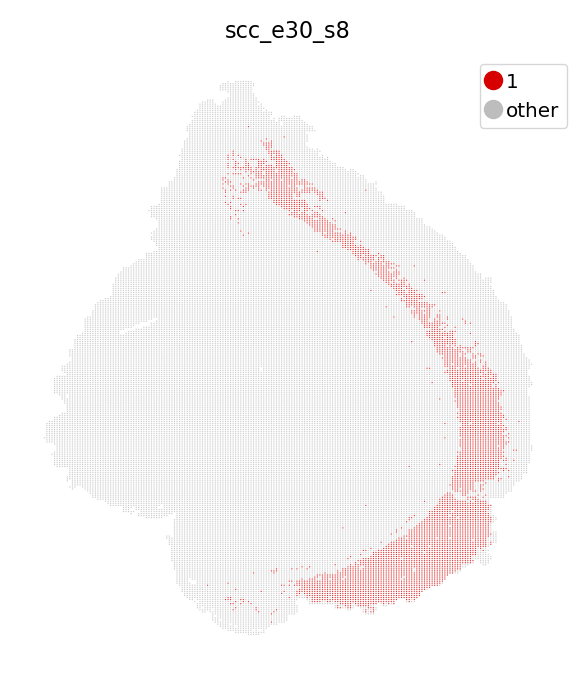

|-----> [space plot] in progress: 100.0000%
|-----> [space plot] finished [0.3707s]


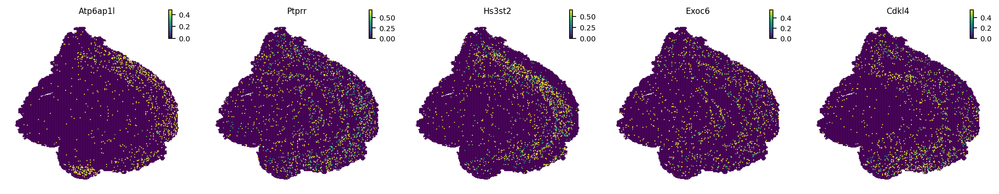

|-----> Plotting spatial info on adata
|-----------> plotting with basis key=X_spatial
|-----------> skip filtering scc_e30_s8 by stack threshold when stacking color because it is not a numeric type


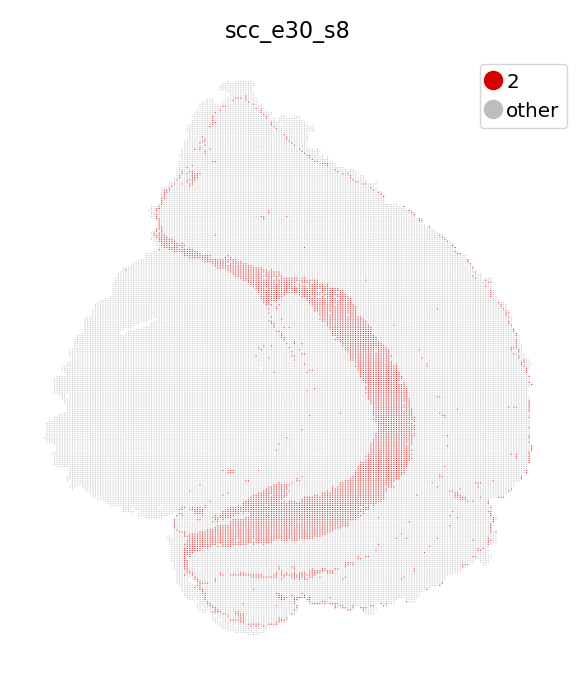

|-----> [space plot] in progress: 100.0000%
|-----> [space plot] finished [0.3547s]


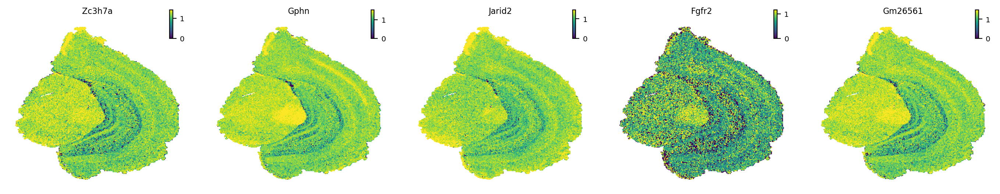

|-----> Plotting spatial info on adata
|-----------> plotting with basis key=X_spatial
|-----------> skip filtering scc_e30_s8 by stack threshold when stacking color because it is not a numeric type


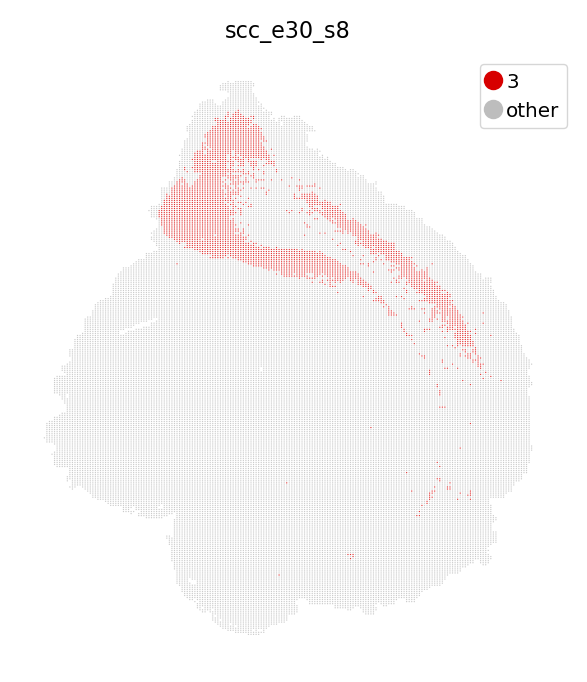

|-----> [space plot] in progress: 100.0000%
|-----> [space plot] finished [0.3502s]


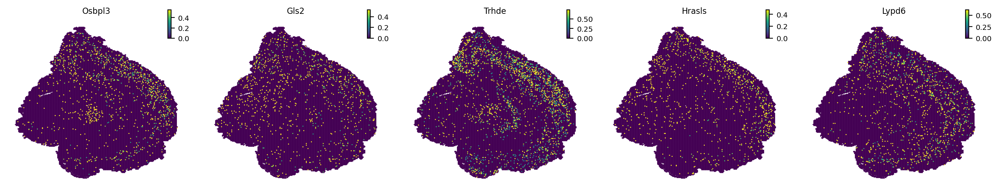

|-----> Plotting spatial info on adata
|-----------> plotting with basis key=X_spatial
|-----------> skip filtering scc_e30_s8 by stack threshold when stacking color because it is not a numeric type


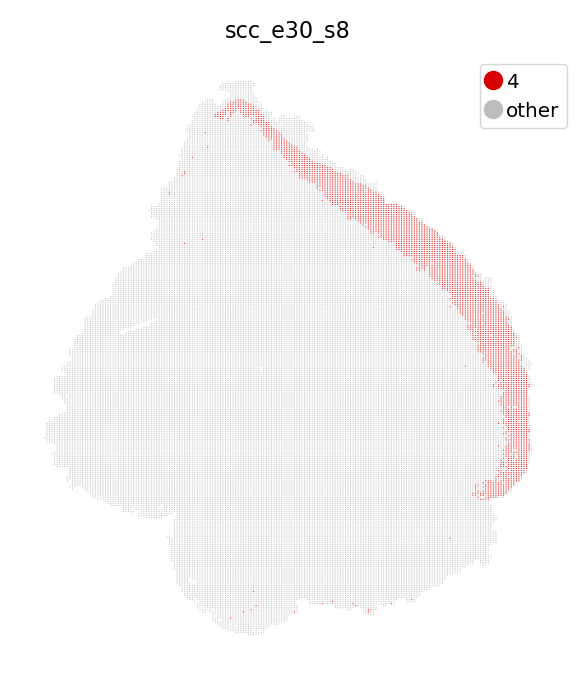

|-----> [space plot] in progress: 100.0000%
|-----> [space plot] finished [0.3296s]


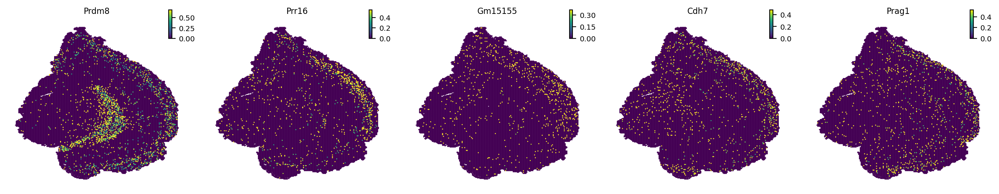

|-----> Plotting spatial info on adata
|-----------> plotting with basis key=X_spatial
|-----------> skip filtering scc_e30_s8 by stack threshold when stacking color because it is not a numeric type


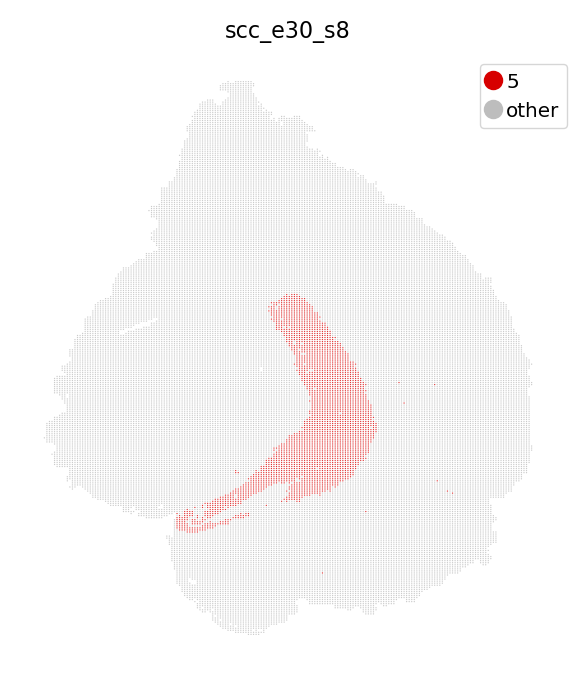

|-----> [space plot] in progress: 100.0000%
|-----> [space plot] finished [0.3277s]


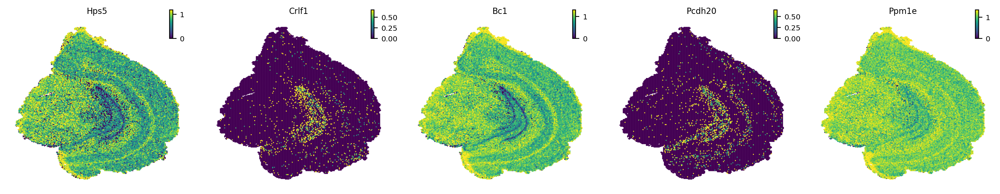

|-----> Plotting spatial info on adata
|-----------> plotting with basis key=X_spatial
|-----------> skip filtering scc_e30_s8 by stack threshold when stacking color because it is not a numeric type


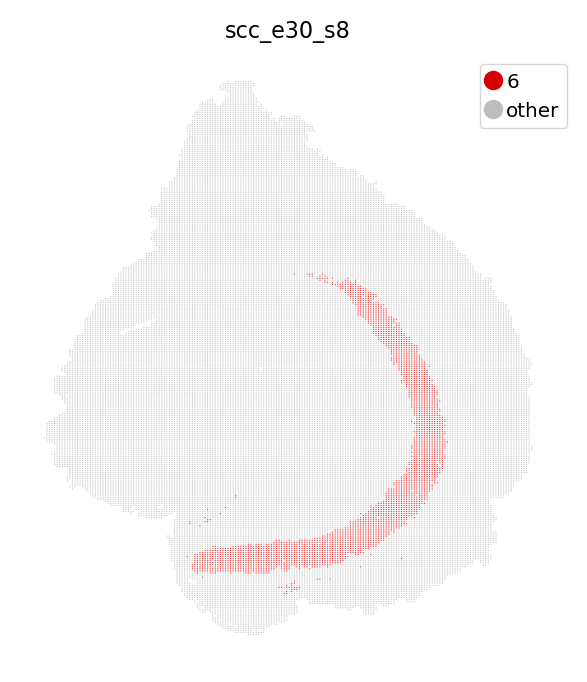

|-----> [space plot] in progress: 100.0000%
|-----> [space plot] finished [0.4924s]


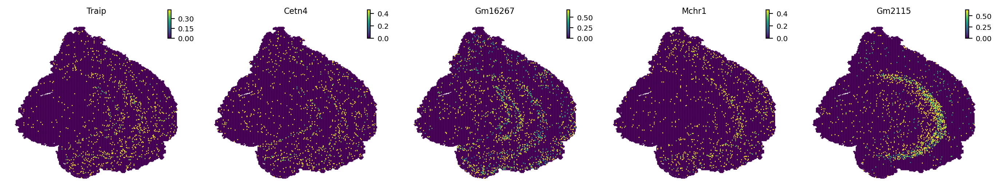

In [14]:
for i in markers_df.index.get_level_values(0).unique().tolist():
    dyn.pl.space(adata,color = 'scc_e30_s8',pointsize=0.01,ncols=3,highlights=[str(i)],show_legend="upper left",figsize=(4,4),)
    st.pl.space(adata, color=markers_df[i].index, pointsize=0.05, alpha=1, figsize=(4, 3),ncols=5)

3. GM_lag_model

In [ ]:
res= st.tl.GM_lag_model(adata_sample,group='scc_e30_s8')

In [5]:
import pandas as pd
#res.to_csv("/home/zuolulu/spatialDEG/test/01.single_slice_mouse_brain_adult/mouse_brain_GM_lag_model.csv")
res = pd.read_csv("/home/zuolulu/spatialDEG/test/01.single_slice_mouse_brain_adult/mouse_brain_GM_lag_model.csv",index_col=0)

In [6]:
df = pd.DataFrame(res).filter(regex='pval')
df = df[df<0.05].dropna(axis=0,how='all')
df = pd.DataFrame(res).loc[df.index,:].filter(regex='coeff').drop(['const_GM_lag_coeff','W_log_exp_GM_lag_coeff'],axis=1)
df = df[df>0.2].dropna(axis=0,how='all')
df

,0_GM_lag_coeff,1_GM_lag_coeff,10_GM_lag_coeff,11_GM_lag_coeff,2_GM_lag_coeff,3_GM_lag_coeff,4_GM_lag_coeff,5_GM_lag_coeff,6_GM_lag_coeff,7_GM_lag_coeff,8_GM_lag_coeff,9_GM_lag_coeff
6330403K07Rik,NaN,NaN,0.310467,0.235288,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Aldh1a1,NaN,NaN,NaN,0.335243,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Arpp21,NaN,0.258911,0.292561,NaN,NaN,NaN,0.351362,NaN,NaN,NaN,NaN,NaN
Aspa,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.205339,NaN,NaN
Atp1a1,NaN,NaN,NaN,NaN,NaN,NaN,0.249567,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...
Trf,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.224870,NaN,NaN
Tspan2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.202831,NaN,NaN
Uqcrq,NaN,NaN,NaN,0.263465,NaN,NaN,NaN,NaN,0.214951,NaN,NaN,NaN
Zcchc12,NaN,NaN,NaN,0.229923,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


|-----> Plotting spatial info on adata
|-----------> plotting with basis key=X_spatial
|-----------> skip filtering scc_e30_s8 by stack threshold when stacking color because it is not a numeric type


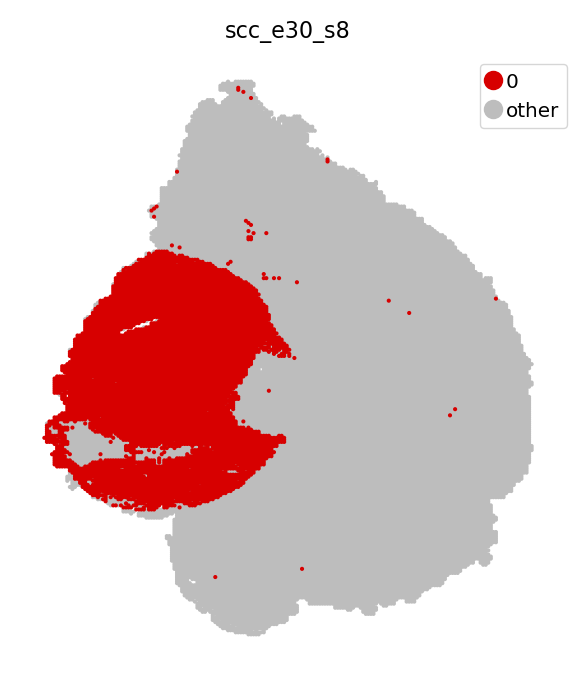

|-----> [space plot] in progress: 100.0000%
|-----> [space plot] finished [0.3231s]


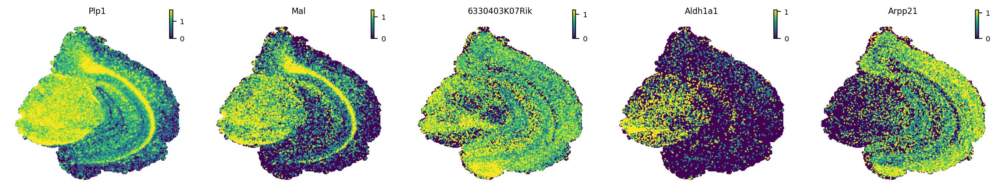

|-----> Plotting spatial info on adata
|-----------> plotting with basis key=X_spatial
|-----------> skip filtering scc_e30_s8 by stack threshold when stacking color because it is not a numeric type


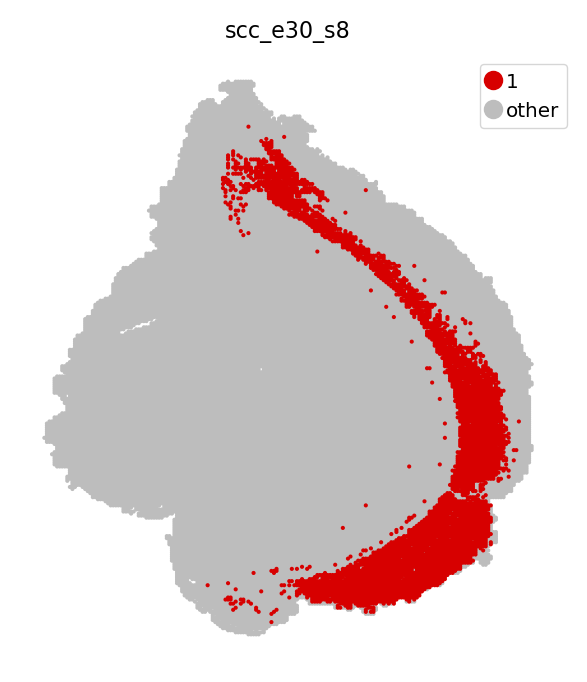

|-----> [space plot] in progress: 100.0000%
|-----> [space plot] finished [0.3228s]


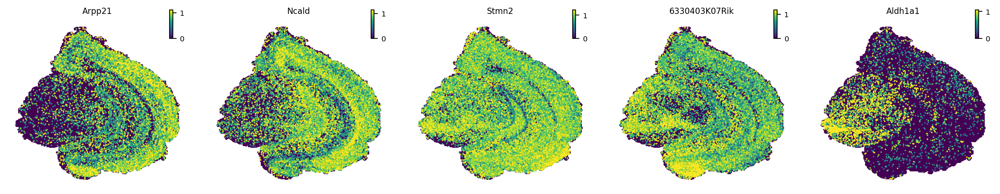

|-----> Plotting spatial info on adata
|-----------> plotting with basis key=X_spatial
|-----------> skip filtering scc_e30_s8 by stack threshold when stacking color because it is not a numeric type


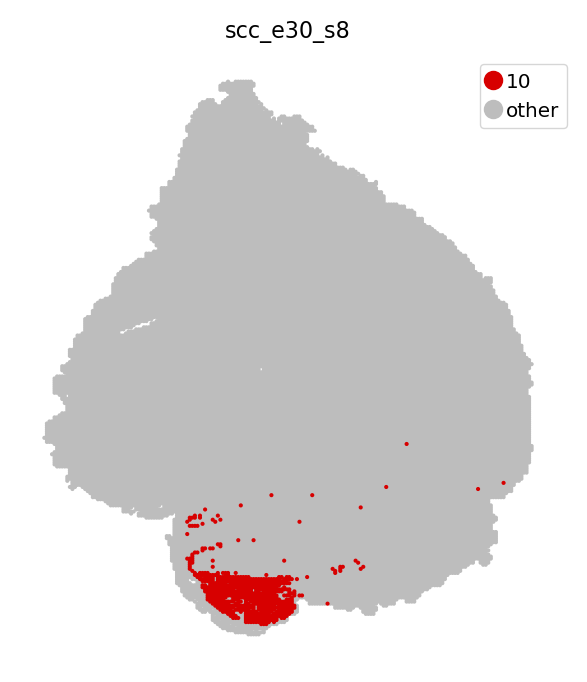

|-----> [space plot] in progress: 100.0000%
|-----> [space plot] finished [0.3281s]


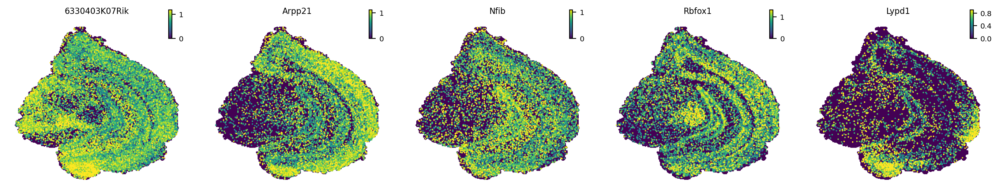

|-----> Plotting spatial info on adata
|-----------> plotting with basis key=X_spatial
|-----------> skip filtering scc_e30_s8 by stack threshold when stacking color because it is not a numeric type


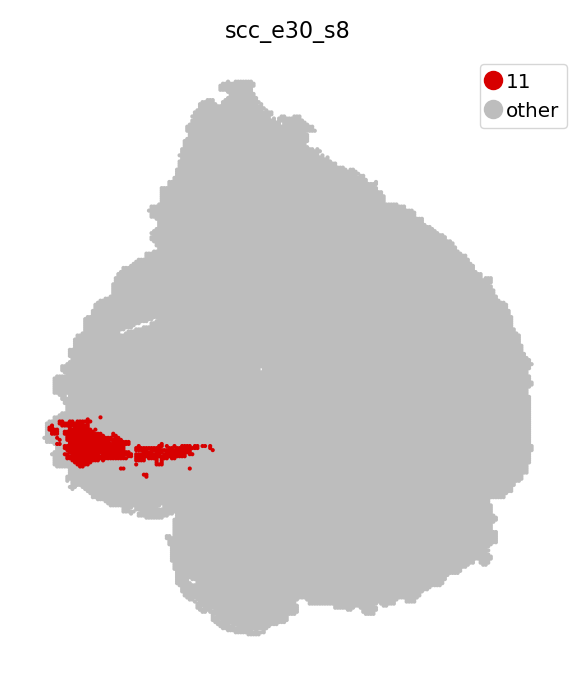

|-----> [space plot] in progress: 100.0000%
|-----> [space plot] finished [0.3343s]


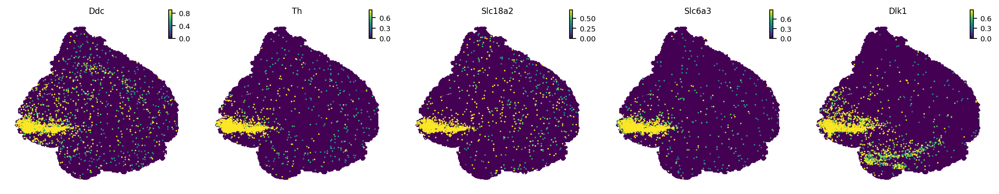

|-----> Plotting spatial info on adata
|-----------> plotting with basis key=X_spatial
|-----------> skip filtering scc_e30_s8 by stack threshold when stacking color because it is not a numeric type


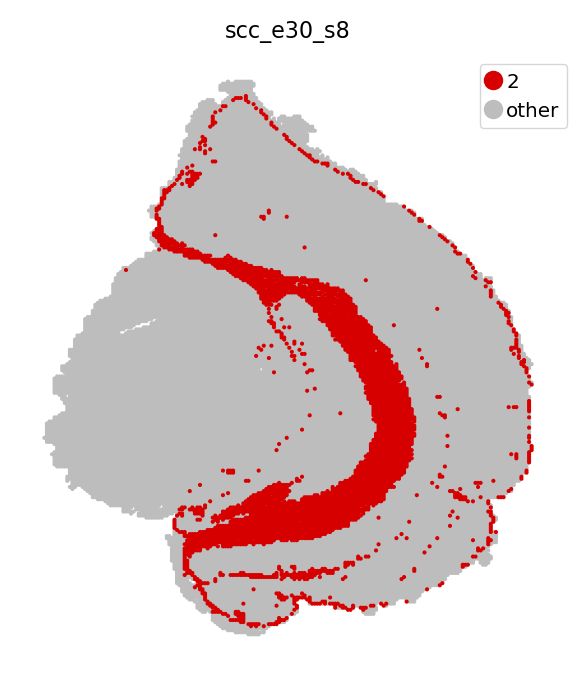

|-----> [space plot] in progress: 100.0000%
|-----> [space plot] finished [0.3320s]


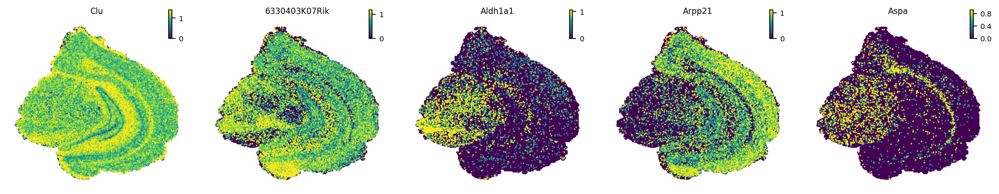

|-----> Plotting spatial info on adata
|-----------> plotting with basis key=X_spatial
|-----------> skip filtering scc_e30_s8 by stack threshold when stacking color because it is not a numeric type


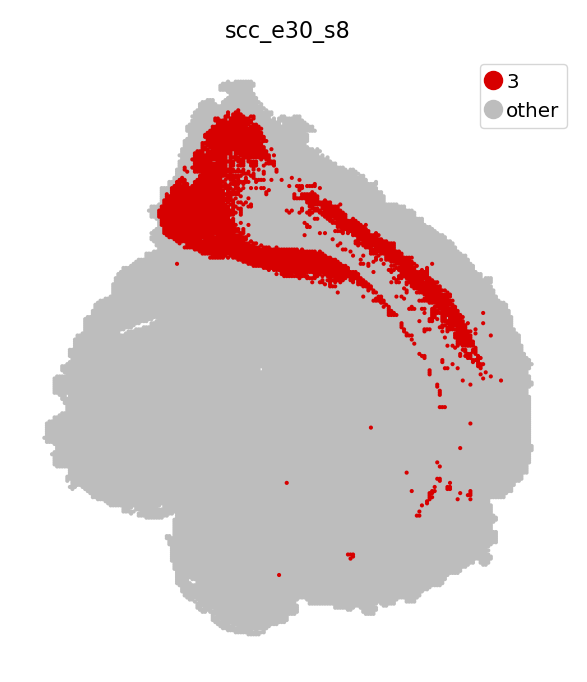

|-----> [space plot] in progress: 100.0000%
|-----> [space plot] finished [0.3275s]


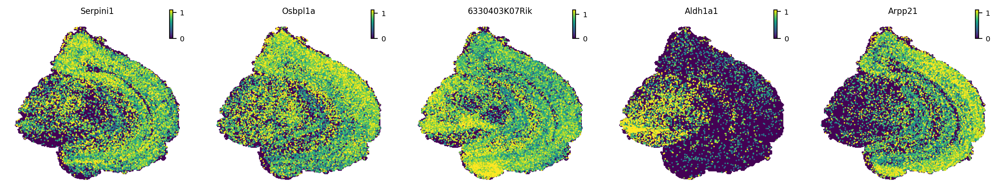

|-----> Plotting spatial info on adata
|-----------> plotting with basis key=X_spatial
|-----------> skip filtering scc_e30_s8 by stack threshold when stacking color because it is not a numeric type


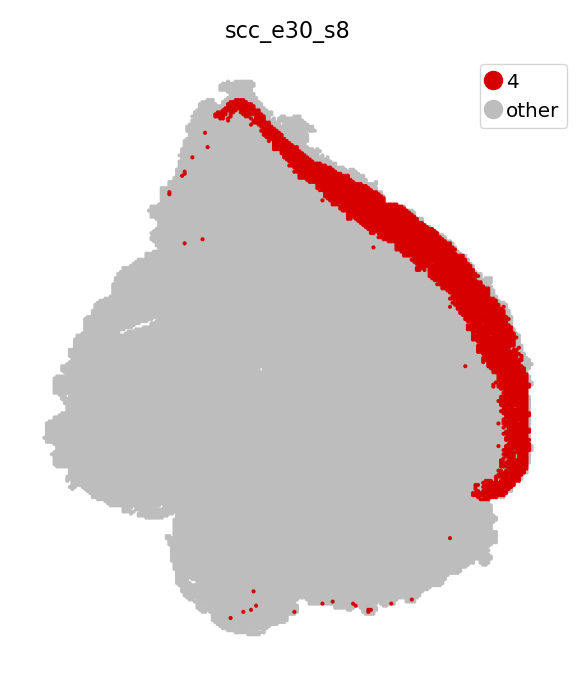

|-----> [space plot] in progress: 100.0000%
|-----> [space plot] finished [0.3251s]


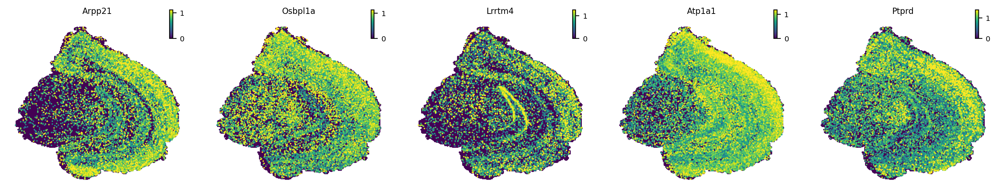

|-----> Plotting spatial info on adata
|-----------> plotting with basis key=X_spatial
|-----------> skip filtering scc_e30_s8 by stack threshold when stacking color because it is not a numeric type


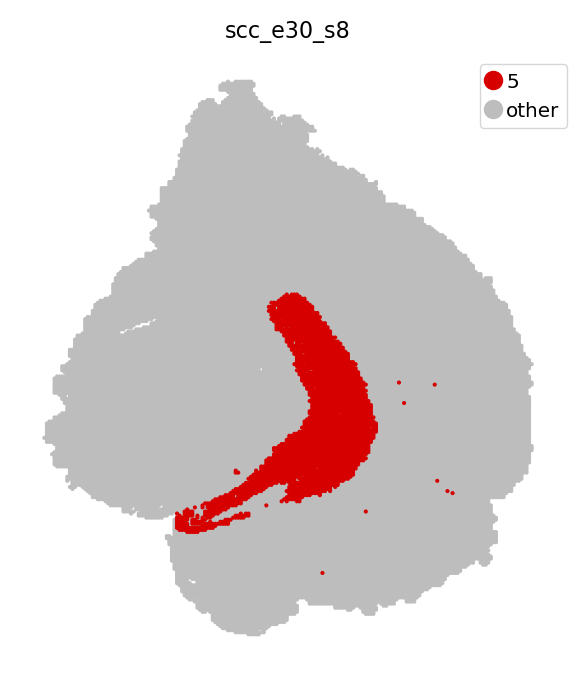

|-----> [space plot] in progress: 100.0000%
|-----> [space plot] finished [0.3226s]


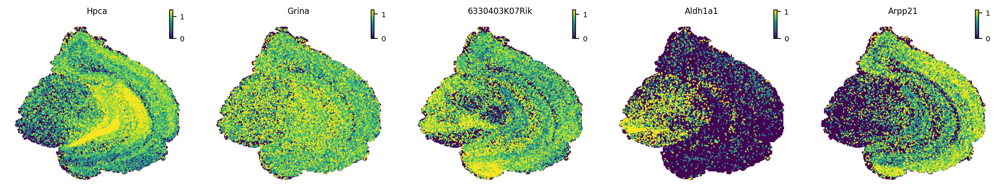

|-----> Plotting spatial info on adata
|-----------> plotting with basis key=X_spatial
|-----------> skip filtering scc_e30_s8 by stack threshold when stacking color because it is not a numeric type


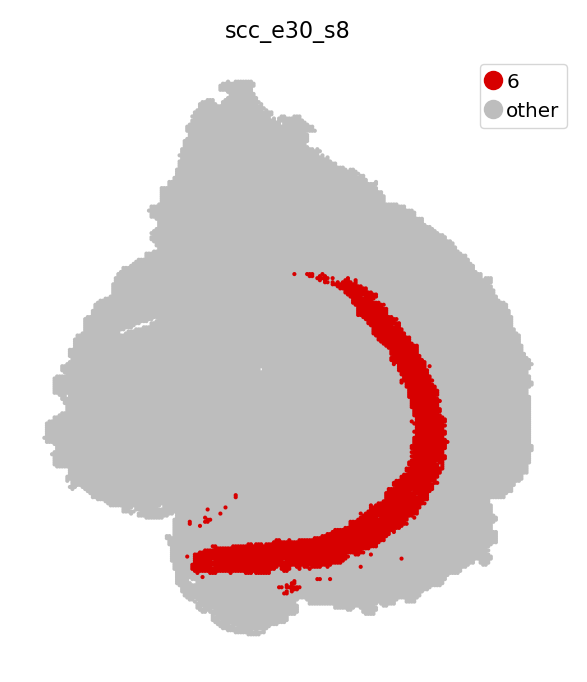

|-----> [space plot] in progress: 100.0000%
|-----> [space plot] finished [0.3233s]


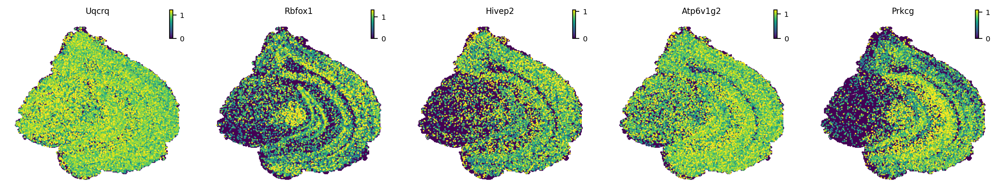

|-----> Plotting spatial info on adata
|-----------> plotting with basis key=X_spatial
|-----------> skip filtering scc_e30_s8 by stack threshold when stacking color because it is not a numeric type


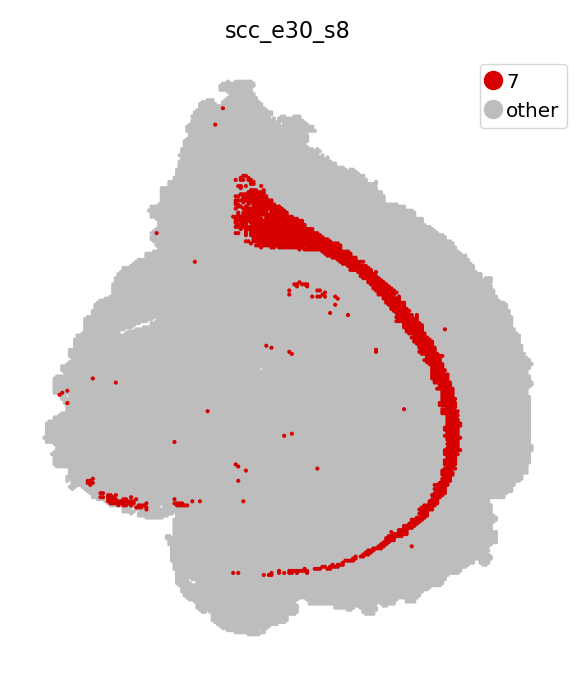

|-----> [space plot] in progress: 100.0000%
|-----> [space plot] finished [0.3314s]


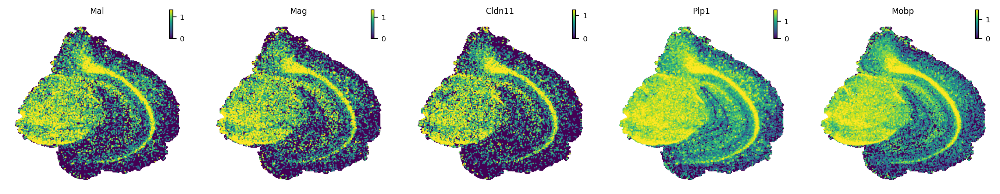

|-----> Plotting spatial info on adata
|-----------> plotting with basis key=X_spatial
|-----------> skip filtering scc_e30_s8 by stack threshold when stacking color because it is not a numeric type


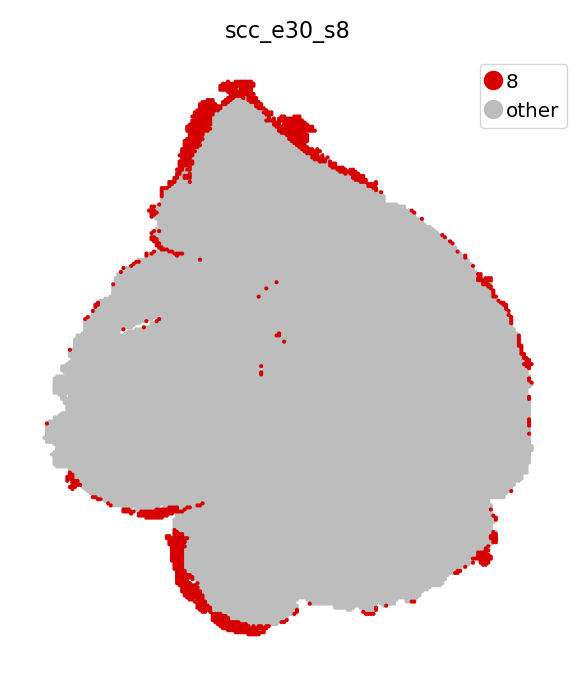

|-----> [space plot] in progress: 100.0000%
|-----> [space plot] finished [0.3245s]


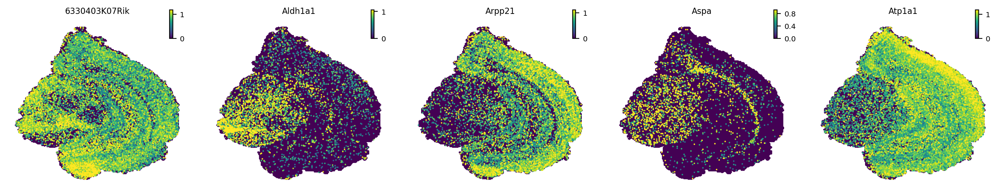

|-----> Plotting spatial info on adata
|-----------> plotting with basis key=X_spatial
|-----------> skip filtering scc_e30_s8 by stack threshold when stacking color because it is not a numeric type


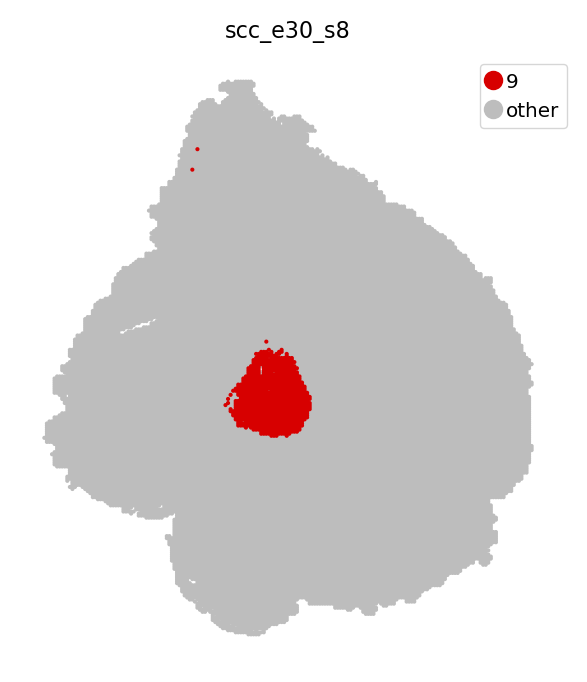

|-----> [space plot] in progress: 100.0000%
|-----> [space plot] finished [0.3210s]


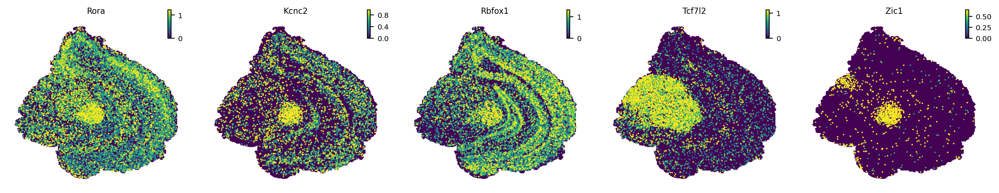

In [7]:
coef_cols = res.columns[res.columns.str.endswith('_GM_lag_coeff')]
for i in coef_cols[1:-1]:
    top_markers = df.sort_values(i, ascending=False).index[:5]
    dyn.pl.space(adata,color=['scc_e30_s8'],highlights=[i.split('_GM_lag_coeff')[0]], pointsize=0.1, alpha=1, show_legend="upper left",figsize=(4,4),)
    st.pl.space(adata, color=top_markers, pointsize=0.1, alpha=1, figsize=(4, 3),ncols=5)